# Description de variables qualitatives

<div style="border:1px solid black; padding:10px; background-color: #F8F8F8;">
    <strong> <b>Notions et fonctions</b></strong><br>.
    <i> Les notions et procédures apparaissant pour la première fois dans le cours sont suivies d'un astérisque
    <ul>
       <li> Variables qualitatives *</li>
        <li> Boucle for, parcourrir une collection d'objet</li>
        <li> Diagramme à barres *</li>
    </ul>
    <strong> Comme d'habitude certaines cellules sont dépendantes de cellules précédentes. Il faut donc les éxécuter en suivant leur ordre dans la page</strong> 
</div>



<b>révisions</b>
<ul>
    <li>Va falloir nettoyer un peu et sans doute créer un nouveau carnet pour la carto </li>
    
</ul>

## Données historiques accessibles

Trouver des données historiuques pour s'exercer c'est pas si simple que ça. Il y a bien des défauts, par exemple [Progedo](https://www.progedo.fr/departements/donnees-historiques-economiques-et-financieres/), mais il faut suivre une procédure complexe et justifier d'un projet de recherches pour avoir droit d'y toucher. <br>
[Crininocorpus](https://criminocorpus.org/fr/outils/##filter=.bases-de-donnees) site par ailleurs remarquable fait exception en fournissant un accès à quelques (trois) tableaux de données très bien présentés. </br>
Il vaut mieux souvent se tourner vers le monde de langue anglaise pour récupérer des datas d'entrâinement de bonne qualité en passant par exemple par [data.world](https://data.world/datasets/history). <br>
La plupart du temps cependant ce sont des données plus à même de nourrir la curiosité du sociologue ou de l'éconmiste que de l'hitorien. 


# Description de variables qualitatives

<div style="text-align:justify;">Les statistiques permettent de décrire des populations constituées d'invididus connu par un certain nombre de variables <br>
Celles-ci sont de plusieurs types. En sciences sociales et particulièrement en histoire nous avons souvent affaire à des variables dites qualitatives qui s'exprime par l'appartenance à une modalité. <br>
Il est plusieurs façons de le dire ou de le comprendre en utilisant le langage commun. Chaque variable correspond à la répartion des individus entre plusieurs ensembles (les personnées, mariées, en couple mais non mariés, célibataire), la modalité exprime l'apartenance à l'un de ces ensembles. Nous pouvons considérer aussi qu'elle exprime non une mesure ou un comptage, mais la décision d'un observateur/classeur décidant en fonctions de conventions toujours socialement et historiquement situées de l'appartenance de l'individu à tel ou tel groupe. Même des événèments qui nous semblent pouvoir être définis par des critères tout à fait objectifs dépendent pour leur enregistrement des décisions d'un acteur social historiquement situé. L'exemple classique est celui du suicide, dont Durkheim notait déjà que les conditions d'enregistrement pouvait varier d'une culture à l'autre. D'où d'ailleurs l'improtance de l'étude des conventions et des conditions du classement dès que nous avons affaire à ce genre de variables. <br>
Il est possible de réaliser un certain nombre de traitements statistiques sur des données comportant des variables qualitatives, le choix est cependant bien moins important que lorsque nous manipulons des données quantitatives, d'où la nécessité souvent de transformer avant traitement les variables qualitatives en variables quantiatives, généraement discrètes. </div>

In [7]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import geopandas as gpd

## Préparer les données

<p style="text-align:justify;">Une étape souvent indispensable lorsque l'on récupère des données d'une enquête depuis une base de donénes quelle que soit sa nature. Très généralement sa structure est déterminée par les exigences du receuil de l'information et non par celles du traitement statistique, ce qui conduit souvnet à la multiplication des variables, de plus très rarement normalisées.  Python est dans cette phase égalmente un outil utile, permettant d'obtenir simplement et rapidement des rapports permettant de vérifier le typage des variables, la densité des variables manquantes toutes infomations nécessaires à la préparation du fichier que l'on utilisera pour l'analyse. </br>
Nous prenons ici exemple d'une base de données d'Arnaud Sauer décrivant les étrangers inscrits dans diverses localités luxembourgeoises durant l'entre-deux-guerres.</div>

### De quel type sont mes variables ? 

In [10]:
chemin_fichier = 'Doc6/dat.xlsx'  
df = pd.read_excel(chemin_fichier)

# Affichage des premières lignes du DataFrame pour vérification
print(df.head())

    ID  ANNÉE                  MENTION  \
0    8   1919     MANQUANT FICHES 1-97   
1   96   1919  Abschrift=Transcription   
2  118   1919  Abschrift=Transcription   
3  246   1919  Abschrift=Transcription   
4   97   1919                       NR   

                        (N°_RENVOI_DECLARATIONS_G-D)  \
0                                                NaN   
1  NIEDERANVEN_1916_?\nDUDELANGE_1909_(LUXEMBOURG...   
2                                              NÉANT   
3                                 DUDELANGE_1919_157   
4      ESCH-SUR-ALZETTE_1918_?\nDIFFERDANGE_1917_524   

          (DECLARATIONS_LIEES) (LIEUX_TRANSIT_SUCCESSIFS) (SEXE)  \
0                          NaN                        NaN    NaN   
1                        NÉANT                       L, L      F   
2                        NÉANT                   A-L, A-L      M   
3    RAPPEL_DUDELANGE_1919_157                     A-L, L      M   
4  RAPPEL_DIFFERDANGE_1917_624                       L, L      M   

 

In [36]:
print(df.dtypes)
# attention à la syntaxe par défaut la fonction n'affiche qu'une dizaine de variable
# Les fichiers sont souvent bien plus volumineux
# Si nous ne voulons pas modifier les paramètres de notre environnement (cela s'appliquerait ensuite à toute analyse
# Il va nous falloir utiliser une boucle dont nous donnons ici juste le code 
## Pour chaque colonne, imprimer le nom et le type de donnée
#for col in df.columns:
 #   print(f"{col}: {df[col].dtype}")
# Cela permet d'appliquer une même fonction, d'effectuer une même opération pour tous les éléments d'un ensemble. 

ID                                 int64
ANNÉE                              int64
MENTION                           object
(N°_RENVOI_DECLARATIONS_G-D)      object
(DECLARATIONS_LIEES)              object
                                   ...  
RENSEIGNEMENTS_COMPLÉMENTAIRES    object
STATISTIQUES                      object
SITE_LUXROOTS                     object
SITE_GENEANET                     object
RECONSTITUTIONS_DUDELANGE         object
Length: 299, dtype: object


In [8]:
## Où sont les valeurs manquantes ?

In [11]:
# Pour chaque colonne, imprimer le nom et le nombre de valeurs manquantes
for col in df.columns:
    print(f"{col}: {df[col].isnull().sum()}")



ID: 0
ANNÉE: 0
MENTION: 0
(N°_RENVOI_DECLARATIONS_G-D): 2
(DECLARATIONS_LIEES): 2
(LIEUX_TRANSIT_SUCCESSIFS): 2
(SEXE): 2
(ANNOTATIONS): 3
(REMARQUES): 2
NOM: 0
(NOM_DIFFÉRENT): 101
PRENOMS: 0
COMMUNE_RESIDENCE: 0
RUE_RESIDENCE: 0
DATE_ENTREE_RESIDENCE: 0
COMMUNE_NAISSANCE_SOURCE: 0
COMMUNE_ACTUELLE_NAISSANCE: 2
REGION_I_ACTUELLE_NAISSANCE: 9
REGION_II_ACTUELLE_NAISSANCE: 3
PAYS_ACTUEL_NAISSANCE: 2
ANNEE_NAISSANCE: 2
LIEU_NAISSANCE_PERE: 0
LIEU_ACTUEL_NAISSANCE_PERE: 2
REGION_NAISSANCE_PERE_I: 7
REGION_NAISSANCE_PERE_II: 2
PAYS_NAISSANCE_PERE: 2
ANNEE_NAISSANCE_PERE: 112
LIEU_NAISSANCE_MERE: 0
LIEU_ACTUEL_NAISSANCE_MERE: 2
REGION_NAISSANCE_MERE_I: 6
REGION_NAISSANCE_MERE_II: 2
PAYS_NAISSANCE_MERE: 2
ANNEE_NAISSANCE_MERE: 112
NATIONALITE_SOURCE: 0
NATIONALITE_NORMALISÉE: 0
PROFESSION: 0
EMPLOYEUR: 0
LIEU_TRAVAIL: 0
SITUATION_SOURCE: 0
SITUATION_NORMALISEE: 0
LIEU_MARIAGE: 63
PRECISIONS_LIEU_MARIAGE: 63
LIEU_ACTUEL_MARIAGE: 65
REGION_MARIAGE_I: 70
REGION_MARIAGE_II: 65
PAYS_MARIAGE: 65
D

<div style="text-align:justify;">Très caractéristique d'un fichier d'enquête de ce type, ce fichier nous propose une matrice de grande dimension (de très nombreuses colonnes) mais très peu dense (on dit aussi creuse), beaucoup des rubriques n'étant que peu ou très peu renseignées (pour certaines variables le renseignement n'est disponible que pour quelqueqs individus). <br>
Cela signale que la structure tabulaire n'est pas très adaptée ici, un fichier Json aurait été plus maniable, mais aussi qu'un important travail de parsing et de recodage serait nécessaire afin d'obtenir des données utilisables facilement pour l'analyse. </div>

## Description de variables qualitatives

<div style="text-align:justify;">Nous utilisons pour la partie ci-dessus un autre jeu de données, fournies par Laurence Guignard et Jean Claude Farcy, dépsoées sur Criminocorpus, qui décrivement l'internement administatif à Bicètre. Cela offre l'avantage de nous donner accès à une présentation des données, mais aussi du contexte sans lequel il est bien difficile de dire quoi que ce soit d'un jeu de données.</div>

In [20]:
chemin_fichier = 'Doc6/data2.xlsx'  
df2 = pd.read_excel(chemin_fichier)

# Affichage des premières lignes du DataFrame pour vérification
print(df.head())

    ID  ANNÉE                  MENTION  \
0    8   1919     MANQUANT FICHES 1-97   
1   96   1919  Abschrift=Transcription   
2  118   1919  Abschrift=Transcription   
3  246   1919  Abschrift=Transcription   
4   97   1919                       NR   

                        (N°_RENVOI_DECLARATIONS_G-D)  \
0                                                NaN   
1  NIEDERANVEN_1916_?\nDUDELANGE_1909_(LUXEMBOURG...   
2                                              NÉANT   
3                                 DUDELANGE_1919_157   
4      ESCH-SUR-ALZETTE_1918_?\nDIFFERDANGE_1917_524   

          (DECLARATIONS_LIEES) (LIEUX_TRANSIT_SUCCESSIFS) (SEXE)  \
0                          NaN                        NaN    NaN   
1                        NÉANT                       L, L      F   
2                        NÉANT                   A-L, A-L      M   
3    RAPPEL_DUDELANGE_1919_157                     A-L, L      M   
4  RAPPEL_DIFFERDANGE_1917_624                       L, L      M   

 

In [23]:

# Pour chaque colonne, imprimer le nom et le type de donnée
for col in df2.columns:
    print(f"{col}: {df2[col].dtype}")

id: int64
nom: object
prenoms: object
age: float64
taille: float64
profession: object
naissance_lieu: object
naissance_departement: object
NumDpt: float64
domicile_commune: object
domicile_adresse_dans_paris: object
domicile_quartier_de_paris: object
marques: object
etat_physique: object
autorite: object
date_entree: datetime64[ns]
motif: object
duree_detention_prevue: object
duree_detention_effective: float64
date_sortie: datetime64[ns]
transfert: object
observations: object
rang: int64


In [24]:
chemin_fichier = 'Doc6/data2.xlsx'  
df2 = pd.read_excel(chemin_fichier)

# Affichage des premières lignes du DataFrame pour vérification
print(df2.head())

    id        nom            prenoms   age  taille  profession  \
0  360    Barbeth          Philibert  46.0   171.0     Cordier   
1  268    Legrain      Pierre Alexis  18.0   170.0     Vannier   
2  683    Ancieux           Benjamin  18.0   168.0     Boucher   
3  751     Clouet      Paul Frédéric  17.0   155.0  Domestique   
4  933  Mettivier  François Philippe  28.0   183.0       Maçon   

     naissance_lieu naissance_departement  NumDpt domicile_commune  ...  \
0          Feillens                   Ain     1.0            Paris  ...   
1      Borlieux [?]                 Aisne     2.0            Paris  ...   
2      Capelle (La)                 Aisne     2.0            Paris  ...   
3  Ferté-Milon (La)                 Aisne     2.0            Paris  ...   
4            Epieds                 Aisne     2.0          Comegis  ...   

                                       etat_physique  \
0  Une petite cicatrice sur le pouce de la main g...   
1  Une forte cicatrice sur le dessus de 

In [1]:
# J'obtiens une première description des données quallitaitives du data frame
description_qualitative = df2.describe(include=[object])

# Affichage de la description
print(description_qualitative)


NameError: name 'df2' is not defined

<div style="text-align:justify;">Le descripitf obtenu est mons riche que ce que l'on obtient lorsqu'on utilise des varaibles quanti. </br>
Pour chaque variable nous voici avec le nombre de lignes contenant une valeur non nulle (attention la valeur nulle n'est dans le contexte python pas la valeur 0, elle signifie que la cellule n'est pas renseignée soit que l'information est manquante, le nombre de modalités différentes pour chaque variable (unique), qui est intéressant parce que une variable comportant un grand nombre de modalités est peu exploitable sans regroupements et recodages, et la modalité la pkus fréquente (la petite vérole est la marque physiue la plus régulièrement notée) ainsi que la fréquence (75 condamnés présentent des marques de petite vérole. </div>

<p style="text-align:justify;">Je peux obtenir une représentation graphqique de la distribution de chaque variable, même si dans ce cas du fait du grand nombre dde modalités cela sera peu lisible pour certaines. </p>

<Figure size 1000x600 with 0 Axes>

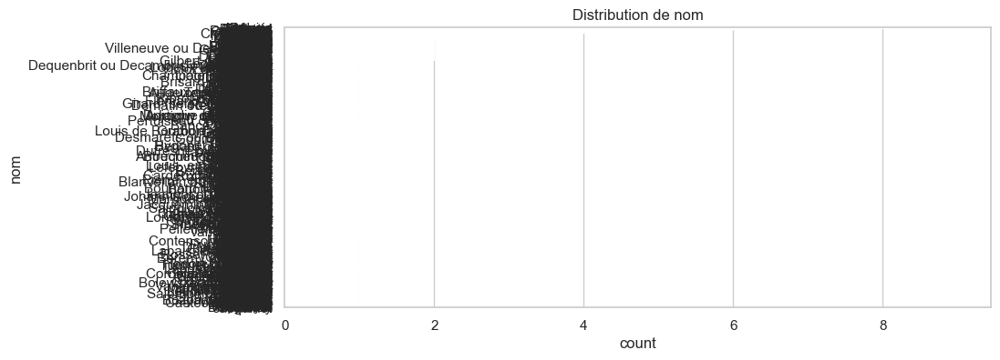

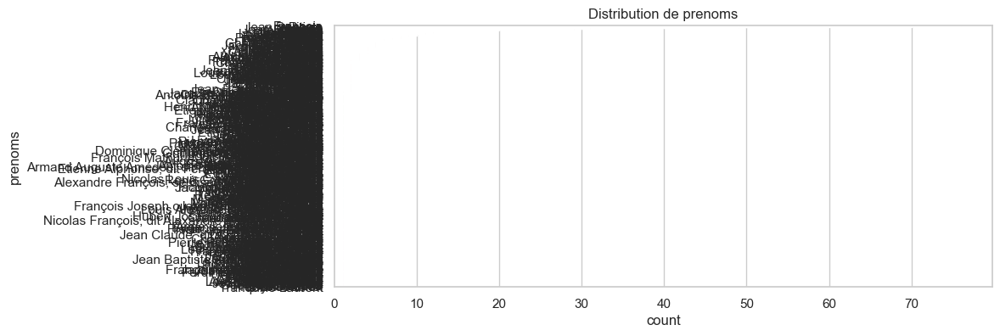

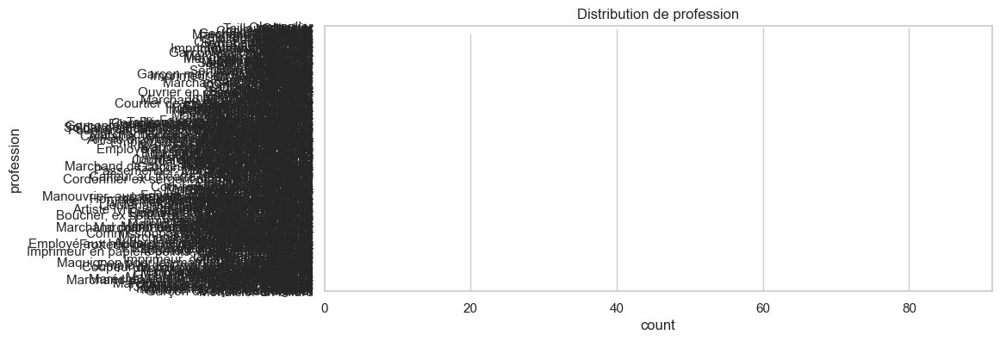

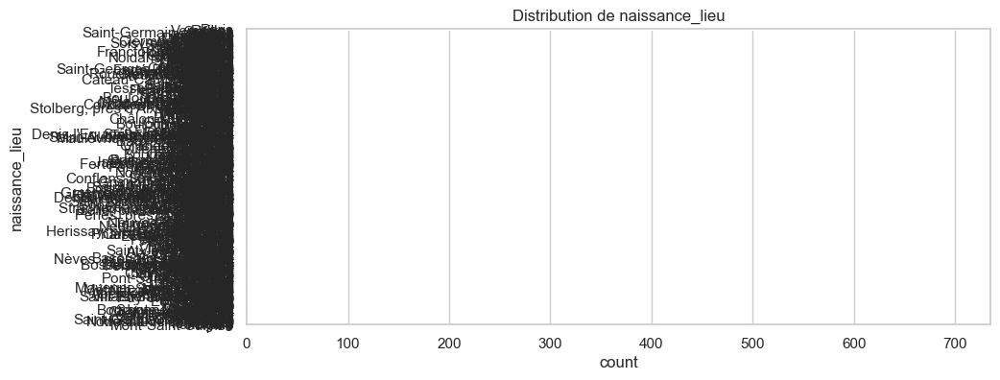

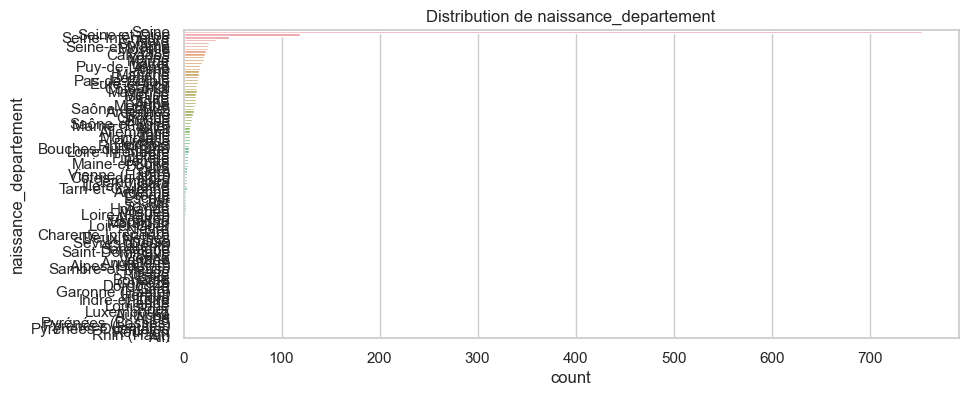

...

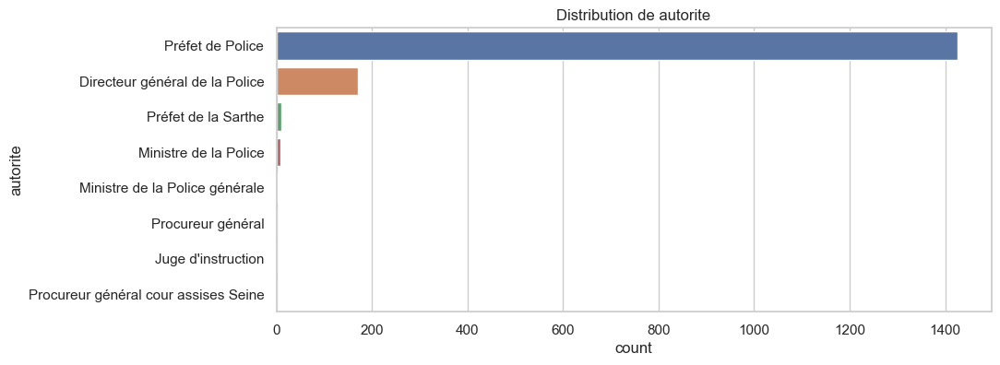

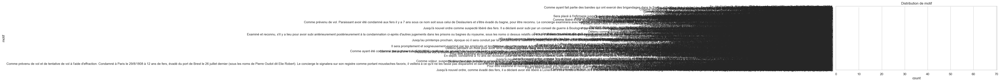

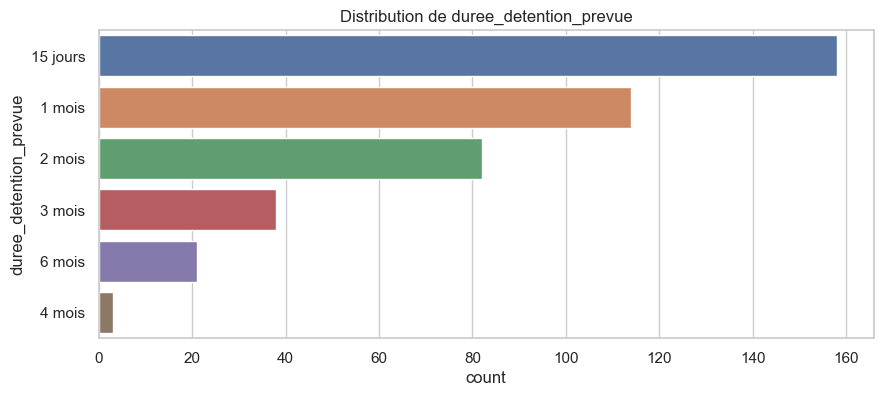

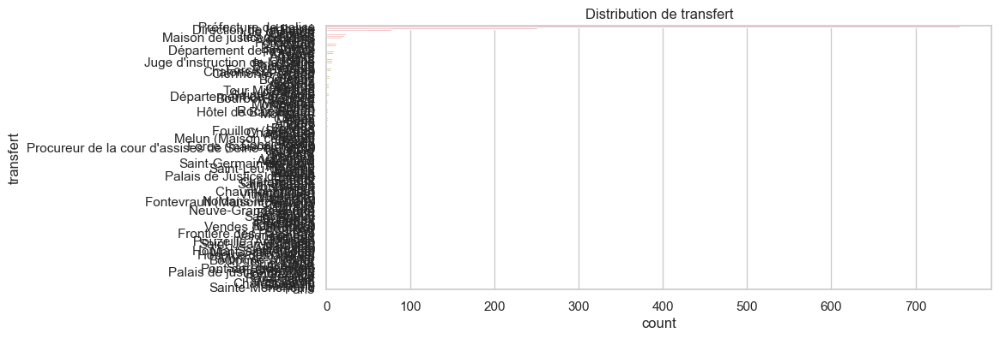

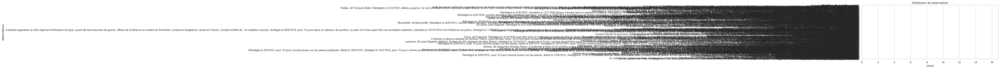

In [41]:

# Configuration de Seaborn. Apparence générale de la figure 
sns.set(style="whitegrid")

# Création d'une figure et ajustement de sa taille
plt.figure(figsize=(10, 6))

# Pour chaque colonne qualitative dans le DataFrame
for column in df2.select_dtypes(include=[object]).columns:
    # Création d'un nouveau subplot pour chaque variable
    plt.figure(figsize=(10, 4))
    
    # Création d'un diagramme à barres pour visualiser la distribution des catégories
    sns.countplot(y=column, data=df2, order = df2[column].value_counts().index)
    
    # Ajout d'un titre
    plt.title(f'Distribution de {column}')
    
    # Affichage du graphique
    plt.show()


<div style="text-align:justify;">Pour les variables distribuant les individus entre un petit nombre de modalités nous obtenons immédiatement quelque chose de très lisible. <br> Nous pouvons voir ainsi que la plupart des prisonniers enregistrés à Bicètre sont adressés par la préfecture de police (l'organisation administrative de Paris est assez spécifique durant la période. Toutes les fonctions de police sont réunies dans les mains du préfet de police le constat est donc peu sureprenant et que la plupart y effectuent un court séjour, de moins de deux mois. </div>

<div style="text-align:justify;">Si nous voulons obtenir des chosse lisibles et utilisables pour les autres variables il nous faut jouer à la fois sur les paramètres d'affichage et l'organisation des variables.<br> Cela suppose de pouvoir observer leur distribution exacte, ce que permet la méthode 'value_counts()4S DE Pandas. <br>
Là encore n'oubliez pas que la plupart des fonctions et méthodes utilisées pour analyser des données supposent que soit active une bibliothèque, donc qu'elle soit importée, et dans le cas d'un carnet jupyter que la cellule contenant les bibliothques utilisées ait été éxécutée au préalable.</div>

### Modification des paramètres d'affichage 

<div style="text-align:justify;">La plupart des fonctions des bibliothèques python peuvent être paramètrés de manière très fine, il est en particulier ici possible d'afficher notre graphique avec des polices de caractères plus petites et une taille plus grande.</div>

<div style="text-align:justify;">Si vous voulez obtenir des informations détaillées sur les paramètres qu'il est possible d'appliquer à une fonction ou une méthode vous pouvez le faire sans quitter le carnet jupyter (même si ce n'est pas la façon la plus élégante de le faire) en l'appelant dans une cellule. </br> 
Vous pouvez bien sûr aussi de nos jours demander des éclaircissements à un LLM ou à un aide à la programmation. Le copilot de GIthub est en particulier très efficace.</div>

In [22]:
help(sns.set_context)


Help on function set_context in module seaborn.rcmod:

set_context(context=None, font_scale=1, rc=None)
    Set the parameters that control the scaling of plot elements.
    
    This affects things like the size of the labels, lines, and other elements
    of the plot, but not the overall style. This is accomplished using the
    matplotlib rcParams system.
    
    The base context is "notebook", and the other contexts are "paper", "talk",
    and "poster", which are version of the notebook parameters scaled by different
    values. Font elements can also be scaled independently of (but relative to)
    the other values.
    
    See :func:`plotting_context` to get the parameter values.
    
    Parameters
    ----------
    context : dict, or one of {paper, notebook, talk, poster}
        A dictionary of parameters or the name of a preconfigured set.
    font_scale : float, optional
        Separate scaling factor to independently scale the size of the
        font elements.
    rc 

In [31]:
help(plt.figure)

Help on function figure in module matplotlib.pyplot:

figure(num: 'int | str | Figure | SubFigure | None' = None, figsize: 'tuple[float, float] | None' = None, dpi: 'float | None' = None, *, facecolor: 'ColorType | None' = None, edgecolor: 'ColorType | None' = None, frameon: 'bool' = True, FigureClass: 'type[Figure]' = <class 'matplotlib.figure.Figure'>, clear: 'bool' = False, **kwargs) -> 'Figure'
    Create a new figure, or activate an existing figure.
    
    Parameters
    ----------
    num : int or str or `.Figure` or `.SubFigure`, optional
        A unique identifier for the figure.
    
        If a figure with that identifier already exists, this figure is made
        active and returned. An integer refers to the ``Figure.number``
        attribute, a string refers to the figure label.
    
        If there is no figure with the identifier or *num* is not given, a new
        figure is created, made active and returned.  If *num* is an int, it
        will be used for the ``

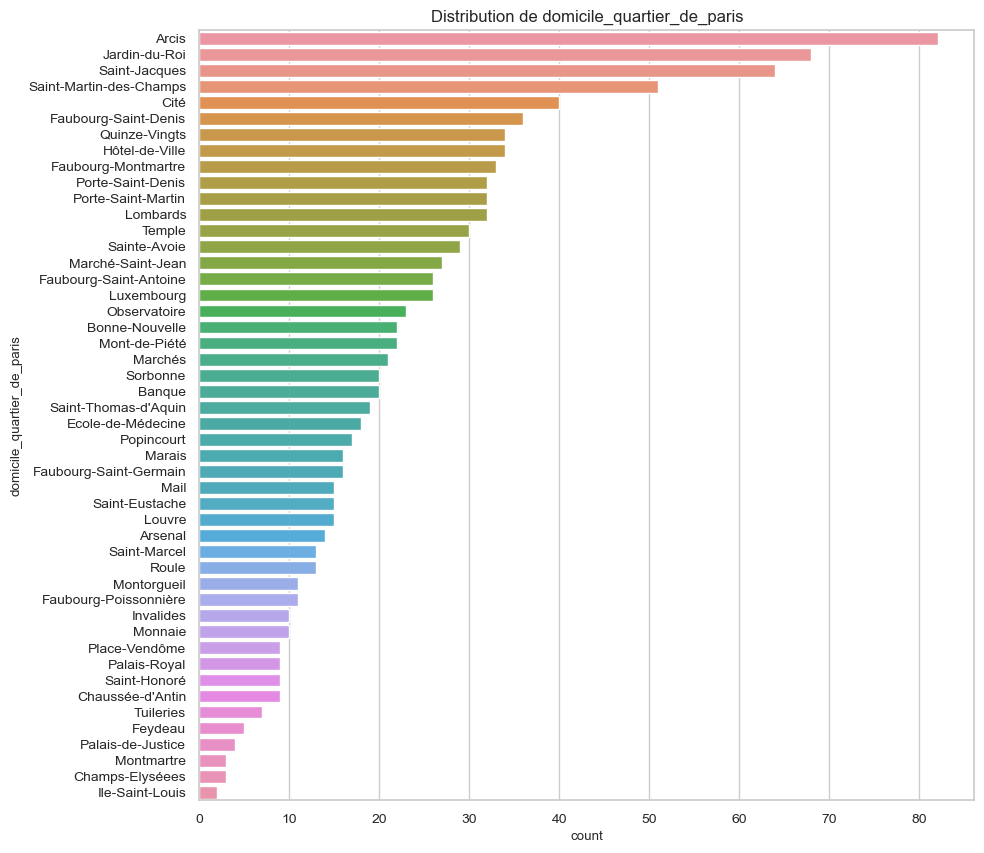

In [18]:

# Configuration de Seaborn pour ajuster la taille de la police
sns.set_context("notebook", font_scale=0.8)  # Réduit la taille de la police

# Création d'une figure plus grande. Ajustez figsize pour les dimensions souhaitées
plt.figure(figsize=(10, 10)) 
# Augmente la taille verticale du graphique


# Création d'un diagramme à barres pour visualiser la distribution des quartiers
sns.countplot(y="domicile_quartier_de_paris", data=df2,
              order=df2["domicile_quartier_de_paris"].value_counts().index)

# Ajustement de la taille de la police directement pour les labels si nécessaire
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# Ajout d'un titre avec une taille de police spécifique
plt.title('Distribution de domicile_quartier_de_paris', fontsize=12)

# Affichage du graphique
plt.show()


<div style="text-align:justify;">Le graphique obtenu est beaucoup plus lisible. Il permet de remarquer que certains quartiers sont beaucoup plus représentés que d'autres. L'échelle est adaptée à une représentation cartographique;, moins à une manipulation statistique. Il faudrait sans doute recoder cette varaible par zones ou par arrondissements (la division de paris en arrondissements date de 1795). Le choix d'une méthode pertinente et efficiente supposerait une connaissance fine de l'espace parisien du premier XIXe siècle. </div>

<p style="text-align:justify;"> Nous pouvons cependant constater que le Paris dessinné par les premiers items ressemble au Paris grouillant pauvre et remuant, au bâti dense et ancien évoqué par Victor Hugo dans les Misérables. Le quartier des Arcis entre place du Châtelet et Hôtel de ville est l'un des plus densément peuplé, celui aussi où se trouve la place de grève ou chaque jour viennent se louer les maçons, rudes étrangers à la ville provenant souvent des montagnes du centre. <br>
"Cette place de Grève, dernier vestige de l’ancien marché aux esclaves de l’Antiquité, était bondée d’hommes hâves et décharnés, mais s’accommodant sans trop de tristesse de leur situation de meurt-de-faim. On les voyait grelottant de froid sous de mauvaises blouses ou des vestes usées jusqu’à la couture, trépignant des pieds sur les pavés pour se réchauffer un peu ", Martin Nadaud, Léonard, maçon de la Creuse,1992 [1895]. 
</div>



In [15]:
from IPython.display import display, Image

display(Image(filename='Doc6/arcis.jpg'))


#### Choix du mode de représentation 

<div style="text-align:justify;"> Il est toujours possible de choisir divers modes de représentation (de visualisation) d'une varible ou d'une combinaison de variable.</br>
Nous avons ici utilisé le diagramme en barres. Celui-ci est le type de graphique le plus adapté à la distirubtion des individus selon les modalités d'une variable qualitative. Il peut être horizontal ou vertical.  Chaque barre représente une modalité de la variable, et la hauteur (resp. longueur) de la barre indique le nombre d'individus (fréquence) pour cette modalité. </br>
Il est parfois présenté dans les manuels sous son nom anglais de <i>barplot</i>. 
Vous trouverez parfois des diagrammes en secteurs (pie chart) comme ci-desous. 
</div>

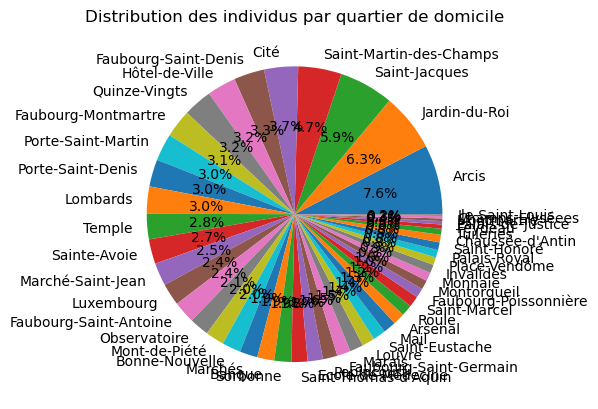

In [26]:
df2['domicile_quartier_de_paris'].value_counts().plot(kind='pie', autopct='%1.1f%%')
plt.ylabel('')  # Supprimer le nom de la colonne en tant que label de l'axe Y
plt.title('Distribution des individus par quartier de domicile')
plt.show()


<div style="text-align:justify;"> Celui-ci est inutilisable ici, du fait du trop grand nombre de modalités. Cette représentation devient de fait illisible dès que votre variable comporte plus de quatre ou cinq modalités. De plus, l'oeil humain percevant beaucoup mieux les longeurs et les hauteurs que les angles, son usage est susceptible d'engendrer des erreurs de lecture. </div>

### Table des fréquences

<p style="text-align:justify;">La description d'une variable qualitative passe aussi généralemnet par la production de la table des fréquences qui donne pour chaque modalité possible de la variable, le nombre de fois où celle-ci est rencontré lorque l'on parcourt le tableau. </br>
La générer est particulièrement simple lorsque l'on utilise Python, il suffit littéralemenet de demander. </br>
                                                                                                              
Cette tableau souvent n'est qu'une étape avant d'autres calculs mais la consulter avnat de procéder à des recodages ou à des examens plus poussés des données est toujours utile. 

In [14]:

# Calcul de la distribution de la variable "naissance_departement"
distribution_naissance_departement = df2['naissance_departement'].value_counts()

# Conversion du résultat en DataFrame pour une meilleure lisibilité
df_distribution = distribution_naissance_departement.reset_index()
df_distribution.columns = ['Modalité', 'Fréquence']
# Nous souhaiton afficher toutes les lignes. 
# La méthode la plus élégante consisterait à générer un document externe pour ne pas surchager le carnet
pd.set_option('display.max_rows', None)
# Affichage du tableau
print(df_distribution)


                Modalité  Fréquence
0                  Seine        753
1          Seine-et-Oise        119
2       Seine-Inférieure         46
3                   Nord         33
4                  Somme         26
5                Moselle         25
6         Seine-et-Marne         25
7                   Oise         23
8               Calvados         22
9                  Yonne         21
10                 Marne         21
11                Loiret         19
12           Puy-de-Dôme         17
13                 Aisne         17
14                Manche         16
15                  Orne         16
16              Belgique         15
17          Eure-et-Loir         15
18         Pas-de-Calais         15
19                Cantal         14
20               Mayenne         14
21             Côte-d'Or         14
22                  Aube         13
23                  Eure         13
24                 Rhône         13
25                 Meuse         13
26               Meurthe    